In [1]:
from fish_helpers import *

In [2]:
md_path = '/hybedata/Images/Zach/MERCI/TBI_Brain_2019Nov04/TBI_20X_1/'
md = Metadata(md_path)

opening img_2-Pos_000_000_000000006_000000000_FarRed_000_006.tif

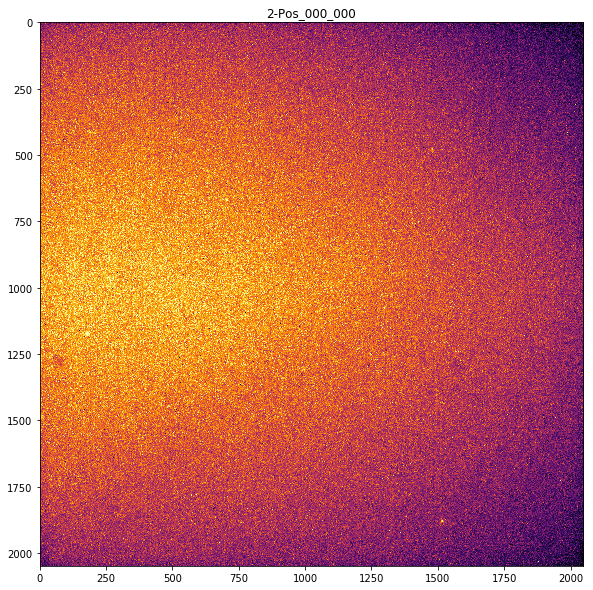

opening img_2-Pos_000_001_000000006_000000000_FarRed_000_006.tif

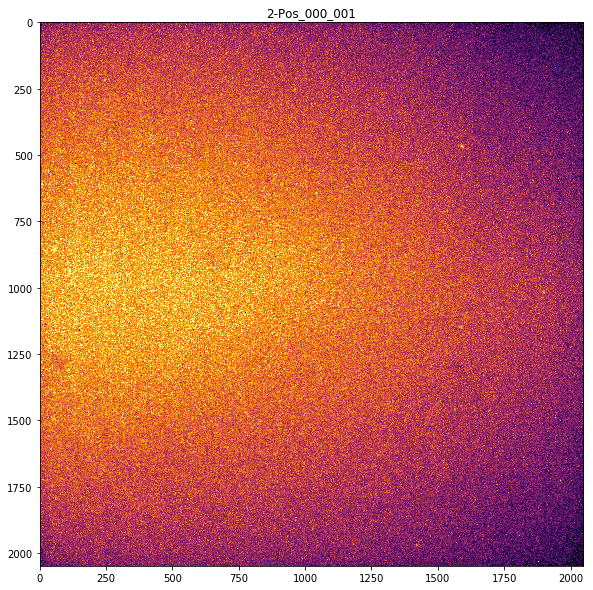

opening img_2-Pos_001_001_000000006_000000000_FarRed_000_006.tif

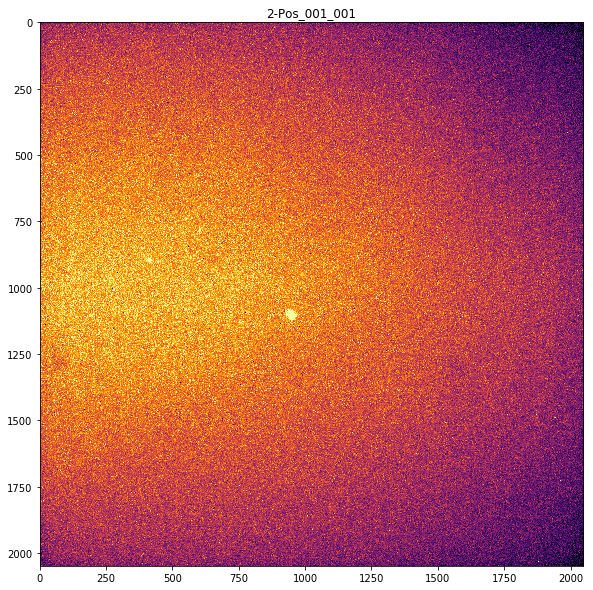

opening img_2-Pos_001_002_000000006_000000000_FarRed_000_006.tif

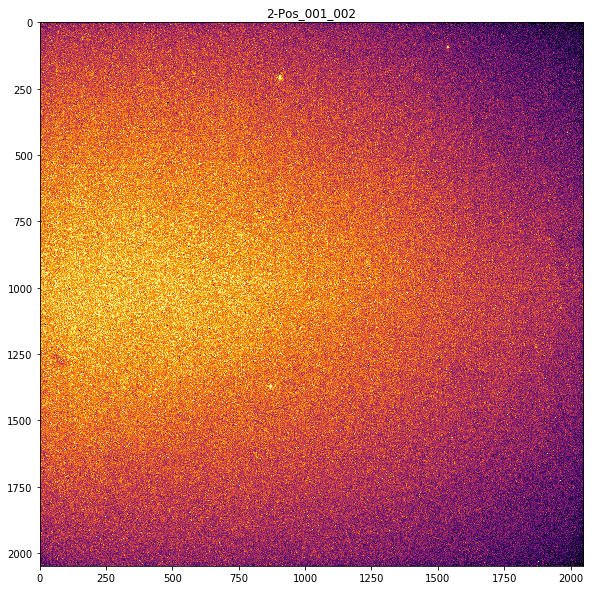

opening img_2-Pos_000_002_000000006_000000000_FarRed_000_006.tif

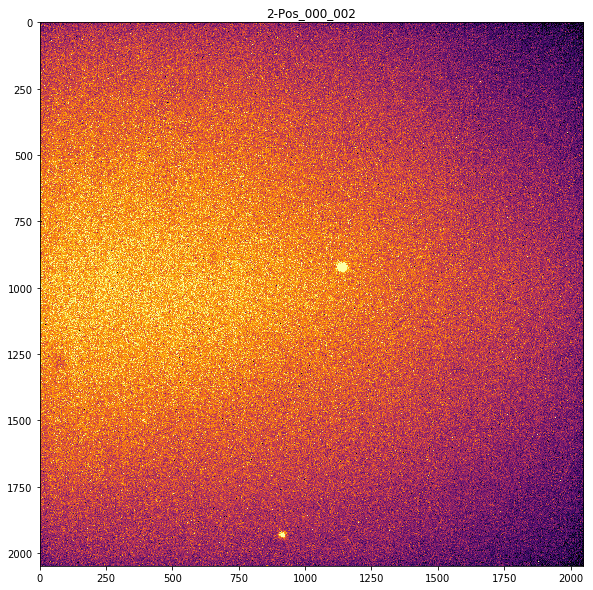

opening img_2-Pos_001_003_000000006_000000000_FarRed_000_006.tif

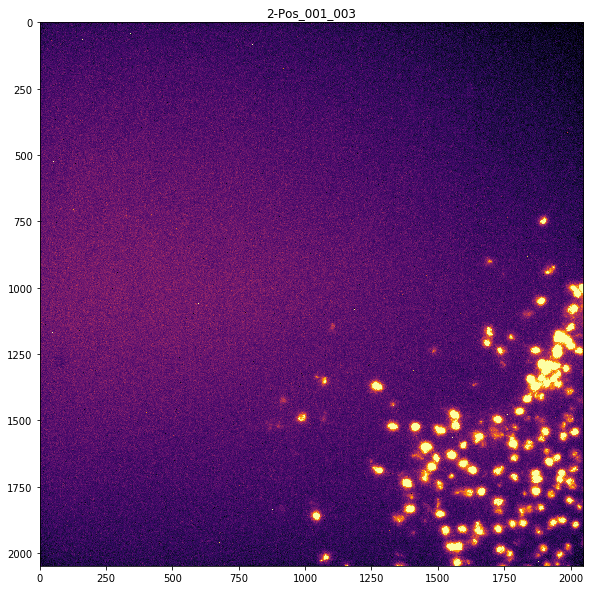

opening img_2-Pos_000_003_000000006_000000000_FarRed_000_006.tif

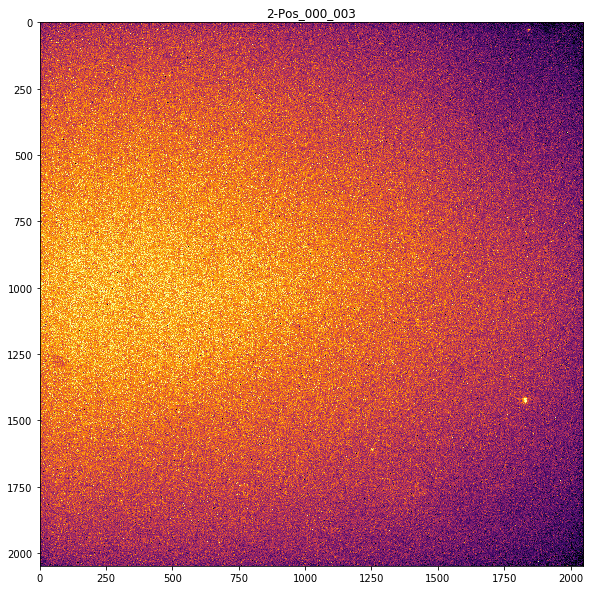

opening img_2-Pos_000_004_000000006_000000000_FarRed_000_006.tif

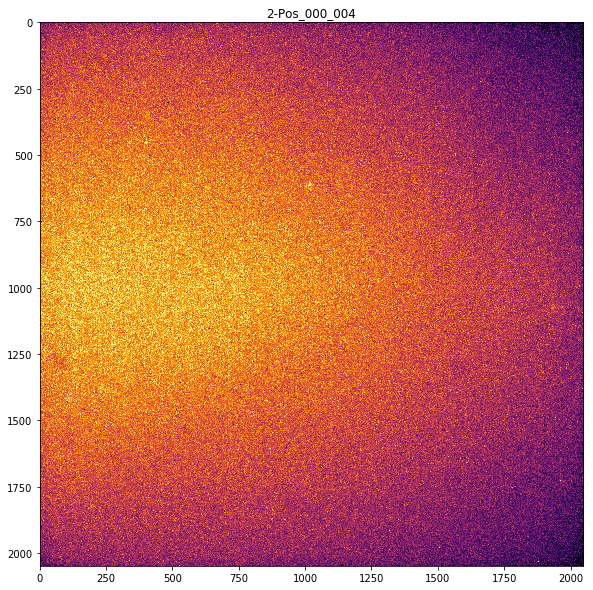

opening img_2-Pos_001_004_000000006_000000000_FarRed_000_006.tif

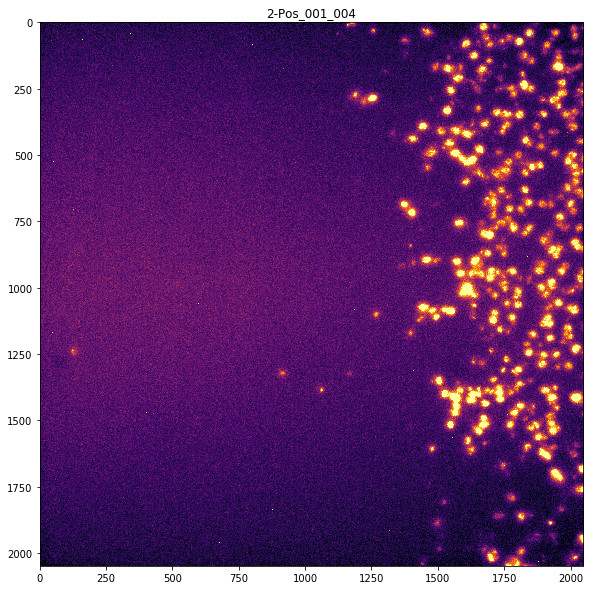

opening img_2-Pos_001_005_000000006_000000000_FarRed_000_006.tif

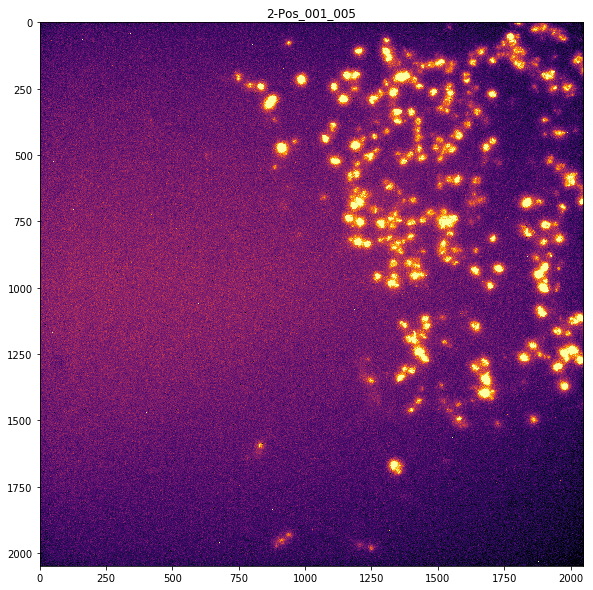

opening img_2-Pos_000_005_000000006_000000000_FarRed_000_006.tif

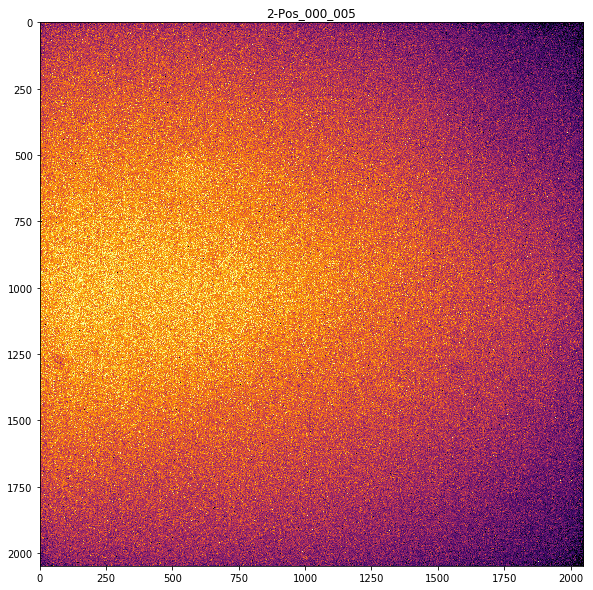

opening img_2-Pos_000_006_000000006_000000000_FarRed_000_006.tif

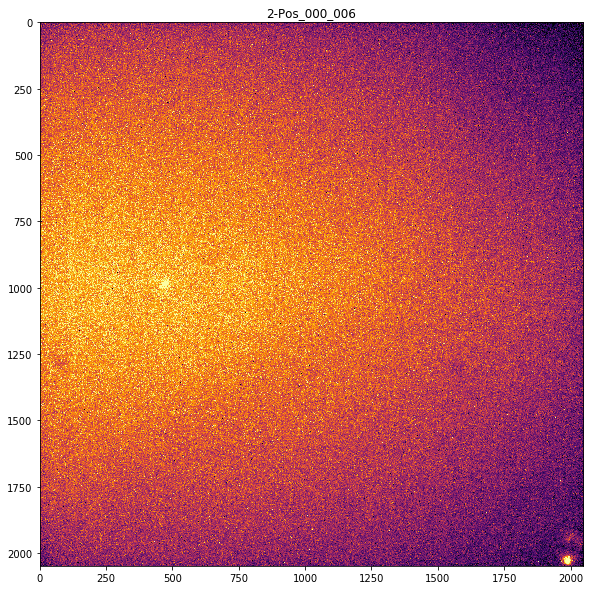

opening img_2-Pos_001_006_000000006_000000000_FarRed_000_006.tif

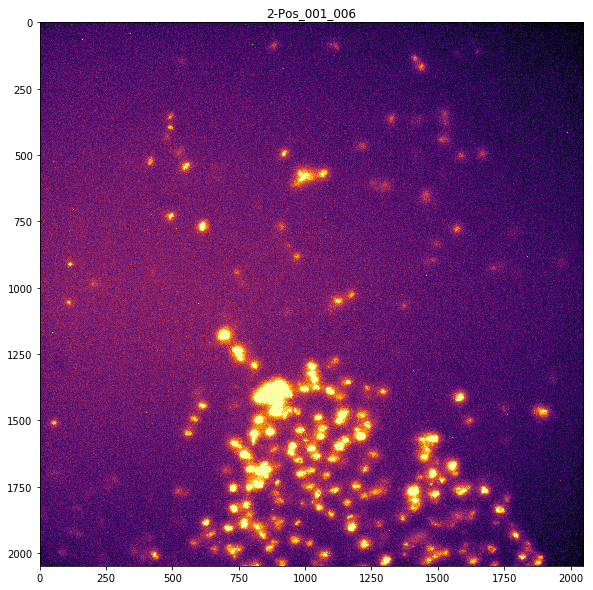

opening img_2-Pos_001_007_000000006_000000000_FarRed_000_006.tif

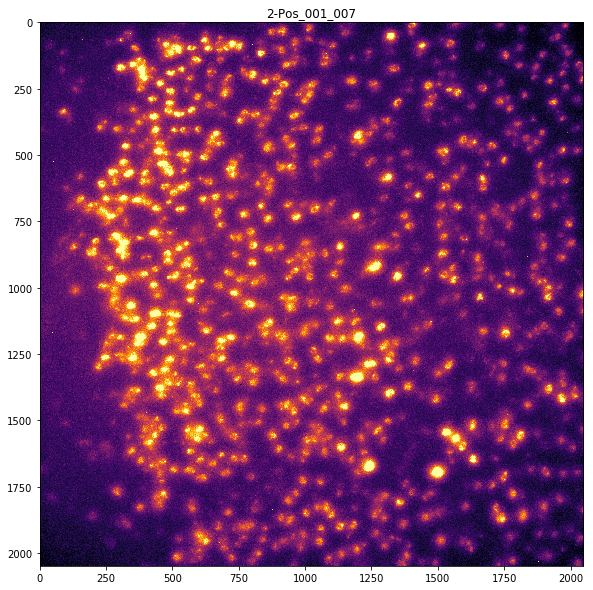

opening img_2-Pos_000_007_000000006_000000000_FarRed_000_006.tif

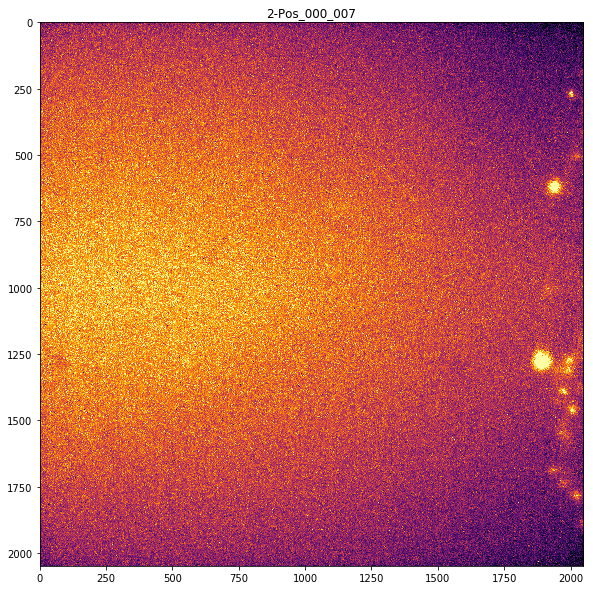

opening img_2-Pos_000_008_000000006_000000000_FarRed_000_006.tif

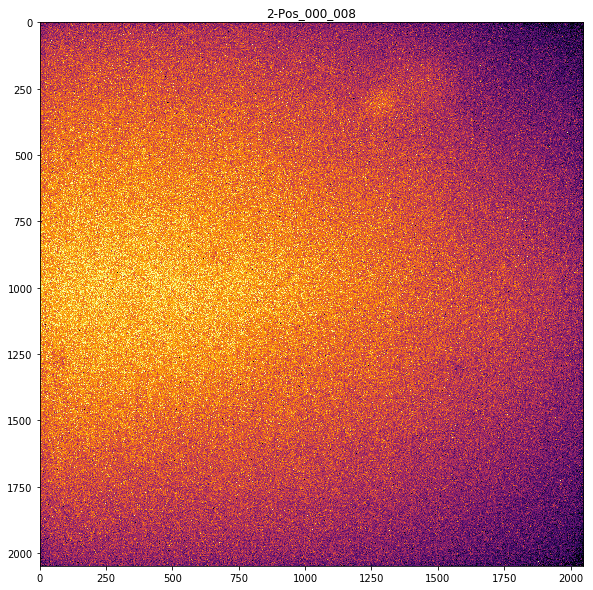

opening img_2-Pos_001_008_000000006_000000000_FarRed_000_006.tif

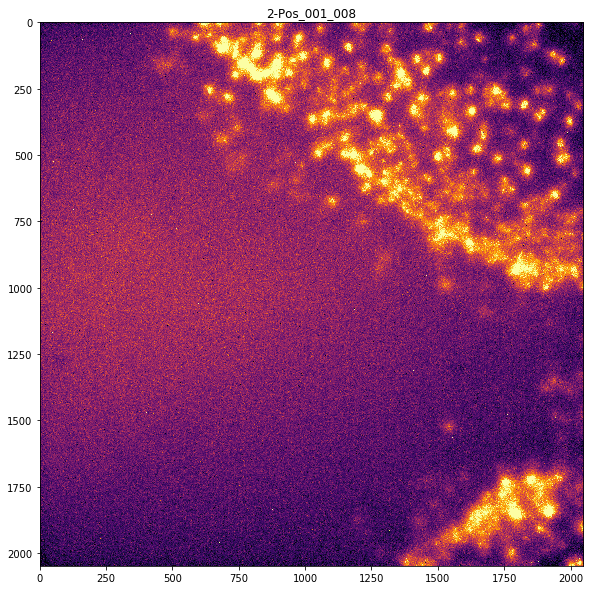

opening img_2-Pos_001_009_000000006_000000000_FarRed_000_006.tif

KeyboardInterrupt: 

In [9]:
channel='FarRed'
fig, ax = plt.subplots()
for pos in md.image_table.Position.unique():
    x,y = md.image_table[md.image_table.Position==pos]['XYbeforeTransform'].iloc[0]
    stk = md.stkread(Position=pos,Channel=channel)
    img = np.max(stk,axis=2)
    image = plt.imread(image)
    ax = plt.gca()
    
    Display(img,title=pos)
    plt.show()

In [13]:
xmin,ymin = np.min(np.stack(md.image_table.XY),axis=0)
xmax,ymax = np.max(np.stack(md.image_table.XY),axis=0)

In [ ]:
%matplotlib inline
from matplotlib import pyplot as plt
import matplotlib as mpl
from skimage.transform import resize
from matplotlib.image import BboxImage
from matplotlib.transforms import Bbox, TransformedBbox
from sklearn.preprocessing import normalize
from scipy import ndimage
from skimage import morphology,filters
import pywt
import cv2
import numpy as np
norm = mpl.colors.Normalize(vmin=0,vmax=1)
fig = plt.figure(figsize=(8,8))#,dpi=300)
ax = fig.add_subplot(111)
artists = []
wavelet = 'db10'
keep_list=[4,5,6]
scale = int(2048*0.32)
BIGGER_SIZE = 12
plt.rc('font', size=BIGGER_SIZE, family='Arial')          # controls default text sizes
plt.rc('axes', titlesize=BIGGER_SIZE)     # fontsize of the axes title
plt.rc('axes', labelsize=BIGGER_SIZE)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=BIGGER_SIZE)    # fontsize of the tick labels
plt.rc('ytick', labelsize=BIGGER_SIZE)    # fontsize of the tick labels
plt.rc('legend', fontsize=BIGGER_SIZE)    # legend fontsize
plt.rc('figure', titlesize=BIGGER_SIZE)  # fontsize of the figure title
xmin,ymin = np.min(np.stack(md.image_table.XY),axis=0)
xmax,ymax = np.max(np.stack(md.image_table.XY),axis=0)
border = 2018*0.32
for pos in tqdm(md.image_table.Position.unique()):
    if 'Pos' in pos:
        x,y = md.image_table[md.image_table.Position==pos].XY.iloc[0]
#         if (x<-100)&(y<2750):
        im = np.flipud(np.max(md.stkread(Position=pos,Channel='FarRed'),axis=2))
        im = cv2.resize(im,dsize=(500,500), interpolation=cv2.INTER_CUBIC)
        thresh = np.percentile(im.ravel(),99)
        im[im>thresh]=thresh
        coeffs = pywt.wavedec2(im,wavelet)
        for i in range(0,len(coeffs)+1):
            if i in keep_list:
                continue
            coeffs[-i] = tuple([np.zeros_like(v) for v in coeffs[-i]])
        Result = pywt.waverec2(coeffs,wavelet)
        thresh = np.percentile(Result.ravel(),99.9)
        Result[Result>thresh]=thresh
        Result[im<2**8.5]=np.nan
        if (x>-2500)&(x<-500)&(y>800)&(y<2000):
            im_bin = im>500
        else:
            im_bin = im>2000
        im_bin = ndimage.binary_dilation(im_bin,iterations=5)
        im_bin = morphology.remove_small_holes(im_bin, 2000)
        im_bin = morphology.remove_small_objects(im_bin, 10000)
        im_bin = morphology.erosion(im_bin)
        Result[im_bin==False]=np.nan
        Result = Result-np.nanpercentile(Result.ravel(),1)
        Result = Result/np.nanpercentile(Result.ravel(),99)
        #Result = im
        bb = Bbox.from_bounds(x,y,scale,scale)
        bb2 = TransformedBbox(bb,ax.transData)
        bbox_image = BboxImage(bb2,
                            norm = norm,
                            origin=None,
                            clip_on=False,
                            cmap='inferno')
        bbox_image.set_data(Result)
        ax.add_artist(bbox_image)
ax.set_xlim(xmin-border,xmax+border)
ax.set_ylim(ymin-border,ymax+border)
ax.set_xticks([])
ax.set_yticks([])
plt.axis('off')
plt.show()

  0%|          | 0/187 [00:00<?, ?it/s]

opening img_2-Pos_000_000_000000006_000000000_FarRed_000_006.tif

  1%|          | 1/187 [00:00<01:38,  1.89it/s]

opening img_2-Pos_000_001_000000006_000000000_FarRed_000_006.tif

  1%|          | 2/187 [00:00<01:24,  2.19it/s]

opening img_2-Pos_001_001_000000006_000000000_FarRed_000_006.tif

  2%|▏         | 3/187 [00:01<01:14,  2.47it/s]

opening img_2-Pos_001_002_000000006_000000000_FarRed_000_006.tif

  2%|▏         | 4/187 [00:01<01:07,  2.72it/s]

opening img_2-Pos_000_002_000000006_000000000_FarRed_000_006.tif

  3%|▎         | 5/187 [00:01<01:02,  2.92it/s]

opening img_2-Pos_001_003_000000006_000000000_FarRed_000_006.tif

  3%|▎         | 6/187 [00:01<00:58,  3.07it/s]

opening img_2-Pos_000_003_000000006_000000000_FarRed_000_006.tif

  4%|▎         | 7/187 [00:02<00:56,  3.20it/s]

opening img_2-Pos_000_004_000000006_000000000_FarRed_000_006.tif

  4%|▍         | 8/187 [00:02<00:54,  3.27it/s]

opening img_2-Pos_001_004_000000006_000000000_FarRed_000_006.tif

  5%|▍         | 9/187 [00:02<00:53,  3.34it/s]

opening img_2-Pos_001_005_000000006_000000000_FarRed_000_006.tif

  5%|▌         | 10/187 [00:03<00:51,  3.41it/s]

opening img_2-Pos_000_005_000000006_000000000_FarRed_000_006.tif

  6%|▌         | 11/187 [00:03<00:50,  3.46it/s]

opening img_2-Pos_000_006_000000006_000000000_FarRed_000_006.tif

  6%|▋         | 12/187 [00:03<00:49,  3.51it/s]

opening img_2-Pos_001_006_000000006_000000000_FarRed_000_006.tif

  7%|▋         | 13/187 [00:03<00:49,  3.54it/s]

opening img_2-Pos_001_007_000000006_000000000_FarRed_000_006.tif

  7%|▋         | 14/187 [00:04<00:48,  3.56it/s]

opening img_2-Pos_000_007_000000006_000000000_FarRed_000_006.tif

  8%|▊         | 15/187 [00:04<00:48,  3.54it/s]

opening img_2-Pos_000_008_000000006_000000000_FarRed_000_006.tif

  9%|▊         | 16/187 [00:04<00:48,  3.54it/s]

opening img_2-Pos_001_008_000000006_000000000_FarRed_000_006.tif

  9%|▉         | 17/187 [00:05<00:47,  3.55it/s]

opening img_2-Pos_001_009_000000006_000000000_FarRed_000_006.tif

 10%|▉         | 18/187 [00:05<00:47,  3.57it/s]

opening img_2-Pos_000_009_000000006_000000000_FarRed_000_006.tif

 10%|█         | 19/187 [00:05<00:46,  3.59it/s]

opening img_2-Pos_000_010_000000006_000000000_FarRed_000_006.tif

 11%|█         | 20/187 [00:05<00:46,  3.59it/s]

opening img_2-Pos_001_010_000000006_000000000_FarRed_000_006.tif

 11%|█         | 21/187 [00:06<00:46,  3.59it/s]

opening img_2-Pos_001_011_000000006_000000000_FarRed_000_006.tif

 12%|█▏        | 22/187 [00:06<00:46,  3.58it/s]

opening img_2-Pos_000_011_000000006_000000000_FarRed_000_006.tif

 12%|█▏        | 23/187 [00:06<00:45,  3.57it/s]

opening img_2-Pos_000_012_000000006_000000000_FarRed_000_006.tif

 13%|█▎        | 24/187 [00:06<00:45,  3.58it/s]

opening img_2-Pos_001_012_000000006_000000000_FarRed_000_006.tif

 13%|█▎        | 25/187 [00:07<00:45,  3.59it/s]

opening img_2-Pos_002_012_000000006_000000000_FarRed_000_006.tif

 14%|█▍        | 26/187 [00:07<00:44,  3.59it/s]

opening img_2-Pos_002_013_000000006_000000000_FarRed_000_006.tif

 14%|█▍        | 27/187 [00:07<00:44,  3.57it/s]

opening img_2-Pos_001_013_000000006_000000000_FarRed_000_006.tif

 15%|█▍        | 28/187 [00:08<00:44,  3.54it/s]

opening img_2-Pos_000_013_000000006_000000000_FarRed_000_006.tif

 16%|█▌        | 29/187 [00:08<00:44,  3.55it/s]

opening img_2-Pos_000_014_000000006_000000000_FarRed_000_006.tif

 16%|█▌        | 30/187 [00:08<00:44,  3.56it/s]

opening img_2-Pos_001_014_000000006_000000000_FarRed_000_006.tif

 17%|█▋        | 31/187 [00:08<00:44,  3.55it/s]

opening img_2-Pos_002_014_000000006_000000000_FarRed_000_006.tif

 17%|█▋        | 32/187 [00:09<00:44,  3.49it/s]

opening img_2-Pos_002_015_000000006_000000000_FarRed_000_006.tif

 18%|█▊        | 33/187 [00:09<00:43,  3.50it/s]

opening img_2-Pos_001_015_000000006_000000000_FarRed_000_006.tif

 18%|█▊        | 34/187 [00:09<00:43,  3.49it/s]

opening img_2-Pos_000_015_000000006_000000000_FarRed_000_006.tif

 19%|█▊        | 35/187 [00:10<00:43,  3.51it/s]

opening img_2-Pos_000_016_000000006_000000000_FarRed_000_006.tif

 19%|█▉        | 36/187 [00:10<00:42,  3.53it/s]

opening img_2-Pos_001_016_000000006_000000000_FarRed_000_006.tif

 20%|█▉        | 37/187 [00:10<00:42,  3.50it/s]

opening img_2-Pos_002_016_000000006_000000000_FarRed_000_006.tif

 20%|██        | 38/187 [00:10<00:42,  3.53it/s]

opening img_2-Pos_003_016_000000006_000000000_FarRed_000_006.tif

 21%|██        | 39/187 [00:11<00:41,  3.53it/s]

opening img_2-Pos_003_015_000000006_000000000_FarRed_000_006.tif

 21%|██▏       | 40/187 [00:11<00:42,  3.47it/s]

opening img_2-Pos_003_014_000000006_000000000_FarRed_000_006.tif

 22%|██▏       | 41/187 [00:11<00:41,  3.49it/s]

opening img_2-Pos_003_013_000000006_000000000_FarRed_000_006.tif

 22%|██▏       | 42/187 [00:12<00:41,  3.49it/s]

opening img_2-Pos_003_012_000000006_000000000_FarRed_000_006.tif

 23%|██▎       | 43/187 [00:12<00:41,  3.49it/s]

opening img_2-Pos_004_012_000000006_000000000_FarRed_000_006.tif

 24%|██▎       | 44/187 [00:12<00:40,  3.50it/s]

opening img_2-Pos_005_012_000000006_000000000_FarRed_000_006.tif

 24%|██▍       | 45/187 [00:12<00:40,  3.54it/s]

opening img_2-Pos_006_012_000000006_000000000_FarRed_000_006.tif

 25%|██▍       | 46/187 [00:13<00:39,  3.55it/s]

opening img_2-Pos_007_012_000000006_000000000_FarRed_000_006.tif

 25%|██▌       | 47/187 [00:13<00:40,  3.48it/s]

opening img_2-Pos_008_012_000000006_000000000_FarRed_000_006.tif

 26%|██▌       | 48/187 [00:13<00:39,  3.48it/s]

opening img_2-Pos_009_012_000000006_000000000_FarRed_000_006.tif

 26%|██▌       | 49/187 [00:14<00:39,  3.51it/s]

opening img_2-Pos_009_013_000000006_000000000_FarRed_000_006.tif

 27%|██▋       | 50/187 [00:14<00:38,  3.53it/s]

opening img_2-Pos_008_013_000000006_000000000_FarRed_000_006.tif

 27%|██▋       | 51/187 [00:14<00:38,  3.53it/s]

opening img_2-Pos_007_013_000000006_000000000_FarRed_000_006.tif

 28%|██▊       | 52/187 [00:14<00:38,  3.52it/s]

opening img_2-Pos_006_013_000000006_000000000_FarRed_000_006.tif

 28%|██▊       | 53/187 [00:15<00:38,  3.52it/s]

opening img_2-Pos_005_013_000000006_000000000_FarRed_000_006.tif

 29%|██▉       | 54/187 [00:15<00:37,  3.54it/s]

opening img_2-Pos_004_013_000000006_000000000_FarRed_000_006.tif

 29%|██▉       | 55/187 [00:15<00:37,  3.54it/s]

opening img_2-Pos_004_014_000000006_000000000_FarRed_000_006.tif

 30%|██▉       | 56/187 [00:16<00:36,  3.56it/s]

opening img_2-Pos_005_014_000000006_000000000_FarRed_000_006.tif

 30%|███       | 57/187 [00:16<00:36,  3.57it/s]

opening img_2-Pos_006_014_000000006_000000000_FarRed_000_006.tif

 31%|███       | 58/187 [00:16<00:36,  3.57it/s]

opening img_2-Pos_007_014_000000006_000000000_FarRed_000_006.tif

 32%|███▏      | 59/187 [00:16<00:35,  3.57it/s]

opening img_2-Pos_008_014_000000006_000000000_FarRed_000_006.tif

 32%|███▏      | 60/187 [00:17<00:35,  3.58it/s]

opening img_2-Pos_009_014_000000006_000000000_FarRed_000_006.tif

 33%|███▎      | 61/187 [00:17<00:35,  3.51it/s]

opening img_2-Pos_009_015_000000006_000000000_FarRed_000_006.tif

 33%|███▎      | 62/187 [00:17<00:36,  3.45it/s]

opening img_2-Pos_008_015_000000006_000000000_FarRed_000_006.tif

 34%|███▎      | 63/187 [00:18<00:37,  3.31it/s]

opening img_2-Pos_007_015_000000006_000000000_FarRed_000_006.tif

 34%|███▍      | 64/187 [00:18<00:37,  3.26it/s]

opening img_2-Pos_006_015_000000006_000000000_FarRed_000_006.tif

 35%|███▍      | 65/187 [00:18<00:37,  3.27it/s]

opening img_2-Pos_005_015_000000006_000000000_FarRed_000_006.tif

 35%|███▌      | 66/187 [00:19<00:37,  3.26it/s]

opening img_2-Pos_004_015_000000006_000000000_FarRed_000_006.tif

 36%|███▌      | 67/187 [00:19<00:37,  3.23it/s]

opening img_2-Pos_004_016_000000006_000000000_FarRed_000_006.tif

 36%|███▋      | 68/187 [00:19<00:36,  3.22it/s]

opening img_2-Pos_005_016_000000006_000000000_FarRed_000_006.tif

 37%|███▋      | 69/187 [00:19<00:36,  3.20it/s]

opening img_2-Pos_006_016_000000001_000000000_FarRed_000_001.tif

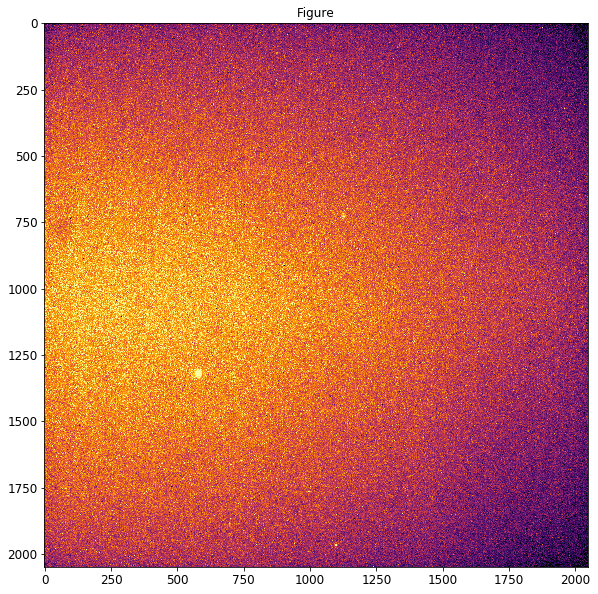

In [10]:
Display(im)

In [18]:
from tqdm import tqdm_notebook as tqdm
for i in tqdm(range(1000000)):
    pass